<a href="https://colab.research.google.com/github/Mo-kw/pothole-detection-yolov8/blob/main/pothole_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Download and Extract Roboflow Dataset**


In [1]:
!curl -L "https://universe.roboflow.com/ds/70N6bAIwYT?key=8OaofQFVNp" -o roboflow.zip && unzip roboflow.zip && rm roboflow.zip


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   893  100   893    0     0   3464      0 --:--:-- --:--:-- --:--:--  3461
100  111M  100  111M    0     0  42.5M      0  0:00:02  0:00:02 --:--:-- 67.1M
Archive:  roboflow.zip
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
   creating: test/
 extracting: test/110_jpg.rf.48742c15a483cc0f54b081a91ae0709b.jpg  
 extracting: test/122_jpg.rf.4ad1a721265951c3695d91ed627c0d3f.jpg  
 extracting: test/128_jpg.rf.8ed813f51c8665bc98f3a4ed3052bd44.jpg  
 extracting: test/162_jpg.rf.dcba552be40525efe03ee602bacb15fc.jpg  
 extracting: test/171_jpg.rf.6271caf0918c5f21921af43b87d77d73.jpg  
 extracting: test/202_jpg.rf.207c2eff454a750ef066f37566f1d5ef.jpg  
 extracting: test/203_jpg.rf.446fd649d1620c12c41774faaadda627.jpg  
 extracting: test/206_jpg.rf.39b5c37bd1a768b85289a6c258df694e.jpg  
 extracting: test/21_j

**Convert COCO Annotations to YOLO Format and Organize Dataset**

In [2]:
import json
import os
import shutil


splits = ['train', 'valid', 'test']
base_dir = '.'
output_dir = 'dataset'

image_extensions = ('.jpg', '.jpeg', '.png')

def convert_coco_to_yolo(coco_json_path, images_dir, output_labels_dir):
    with open(coco_json_path, 'r') as f:
        coco = json.load(f)

    os.makedirs(output_labels_dir, exist_ok=True)


    categories = coco.get('categories', [])
    category_id_to_class_id = {cat['id']: i for i, cat in enumerate(categories)}

    images = {img['id']: img for img in coco.get('images', [])}
    annotations_per_image = {}
    for ann in coco.get('annotations', []):
        img_id = ann['image_id']
        annotations_per_image.setdefault(img_id, []).append(ann)

    for img_id, img_info in images.items():
        img_width = img_info['width']
        img_height = img_info['height']
        img_filename = img_info['file_name']

        label_filename = os.path.splitext(img_filename)[0] + '.txt'
        label_path = os.path.join(output_labels_dir, label_filename)

        anns = annotations_per_image.get(img_id, [])

        with open(label_path, 'w') as f:
            for ann in anns:
                category_id = ann['category_id']
                class_id = category_id_to_class_id[category_id]

                x_min, y_min, width, height = ann['bbox']


                x_center = (x_min + width / 2) / img_width
                y_center = (y_min + height / 2) / img_height
                w_norm = width / img_width
                h_norm = height / img_height

                f.write(f"{class_id} {x_center:.6f} {y_center:.6f} {w_norm:.6f} {h_norm:.6f}\n")

def copy_images(src_dir, dest_dir, extensions=image_extensions):
    os.makedirs(dest_dir, exist_ok=True)
    for file_name in os.listdir(src_dir):
        if file_name.lower().endswith(extensions):
            shutil.copy2(os.path.join(src_dir, file_name), os.path.join(dest_dir, file_name))

if __name__ == '__main__':
    for split in splits:
        print(f"Processing split: {split}")

        split_dir = os.path.join(base_dir, split)
        coco_json_path = os.path.join(split_dir, '_annotations.coco.json')

        if not os.path.isfile(coco_json_path):
            print(f"❗ Annotation file not found: {coco_json_path}, skipping.")
            continue

        images_dir = split_dir
        labels_output_dir = os.path.join(output_dir, 'labels', split)
        images_output_dir = os.path.join(output_dir, 'images', split)


        convert_coco_to_yolo(coco_json_path, images_dir, labels_output_dir)
        print(f"Converted COCO annotations to YOLO format for '{split}' split.")

        # Copy images to new location
        copy_images(images_dir, images_output_dir)
        print(f"Copied images for '{split}' split.")

    print(" All splits processed successfully.")


Processing split: train
Converted COCO annotations to YOLO format for 'train' split.
Copied images for 'train' split.
Processing split: valid
Converted COCO annotations to YOLO format for 'valid' split.
Copied images for 'valid' split.
Processing split: test
Converted COCO annotations to YOLO format for 'test' split.
Copied images for 'test' split.
✅ All splits processed successfully.


**Visualize YOLO Bounding Boxes on Sample Images**

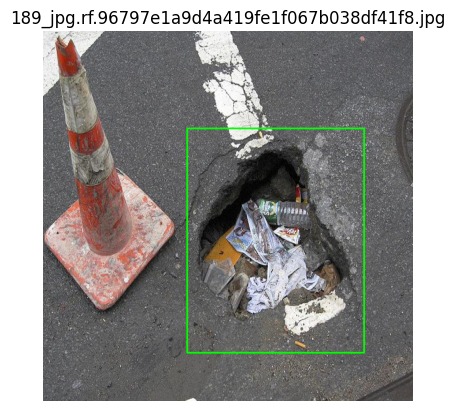

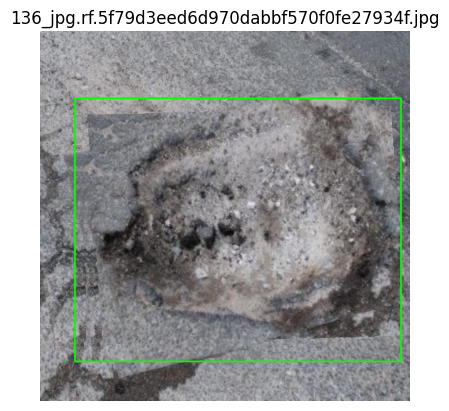

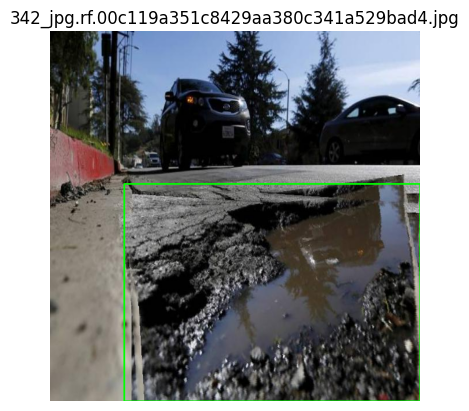

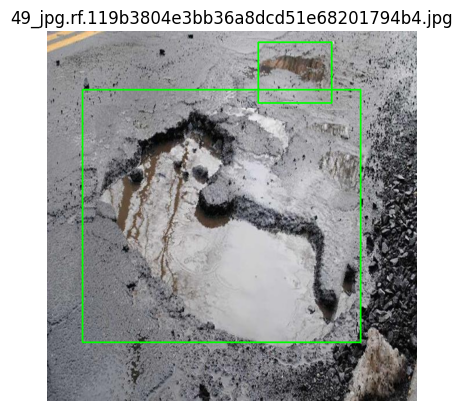

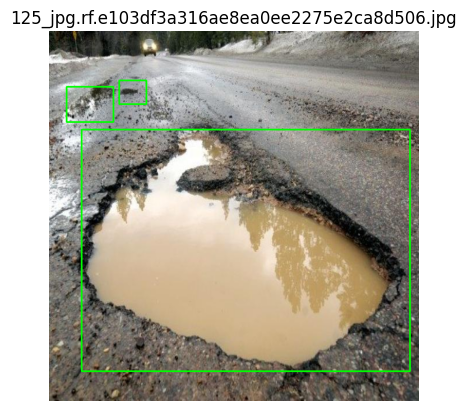

In [3]:
import os
import random
import cv2
import matplotlib.pyplot as plt

dataset_dir = 'dataset'
images_dir = os.path.join(dataset_dir, 'images', 'train')
labels_dir = os.path.join(dataset_dir, 'labels', 'train')


image_files = [f for f in os.listdir(images_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]


sample_images = random.sample(image_files, 5)

for img_file in sample_images:
    img_path = os.path.join(images_dir, img_file)
    label_file = os.path.splitext(img_file)[0] + '.txt'
    label_path = os.path.join(labels_dir, label_file)

    image = cv2.imread(img_path)
    if image is None:
        print(f"Could not read image {img_path}")
        continue

    height, width = image.shape[:2]


    if os.path.isfile(label_path):
        with open(label_path, 'r') as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) != 5:
                    continue

                class_id, x_center, y_center, w, h = parts
                x_center, y_center, w, h = map(float, (x_center, y_center, w, h))

                x_min = int((x_center - w / 2) * width)
                y_min = int((y_center - h / 2) * height)
                x_max = int((x_center + w / 2) * width)
                y_max = int((y_center + h / 2) * height)


                cv2.rectangle(image, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)

    else:
        print(f"No label file found for {img_file}")


    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    plt.imshow(image_rgb)
    plt.title(img_file)
    plt.axis('off')
    plt.show()


**Generate YOLO Dataset Configuration (dataset.yaml)**

In [4]:
import yaml

def create_dataset_yaml(output_path='dataset.yaml'):
    data = {
        'train': 'dataset/images/train',
        'val': 'dataset/images/valid',
        'nc': 1,
        'names': ['pothole']
    }

    with open(output_path, 'w') as f:
        yaml.dump(data, f, default_flow_style=False)

    print(f"✅ '{output_path}' created with 1 class: pothole")

if __name__ == '__main__':
    create_dataset_yaml()


✅ 'dataset.yaml' created with 1 class: pothole


**Install Ultralytics Library**

In [5]:
pip install ultralytics


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 27.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 70.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 36.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 51.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 15.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 98.7 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling 

**Fix Class IDs in YOLO Labels (Convert Class 1 to 0)**

In [6]:
import os

labels_root = 'dataset/labels'
splits = ['train', 'valid', 'test']

for split in splits:
    split_dir = os.path.join(labels_root, split)
    if not os.path.isdir(split_dir):
        continue
    print(f"Fixing labels in {split}...")
    for fname in os.listdir(split_dir):
        if not fname.endswith('.txt'):
            continue
        path = os.path.join(split_dir, fname)
        with open(path, 'r') as f:
            lines = f.readlines()
        new_lines = []
        for line in lines:
            parts = line.strip().split()
            if parts[0] == '1':
                parts[0] = '0'
            new_lines.append(" ".join(parts) + "\n")
        with open(path, 'w') as f:
            f.writelines(new_lines)
print("Done fixing class IDs.")


Fixing labels in train...
Fixing labels in valid...
Fixing labels in test...
Done fixing class IDs.


**Remove Empty YOLO Labels and Corresponding Images**

In [8]:
import os

labels_root = 'dataset/labels'
images_root = 'dataset/images'
splits = ['train', 'valid', 'test']
image_extensions = ('.jpg', '.jpeg', '.png')

for split in splits:
    labels_dir = os.path.join(labels_root, split)
    images_dir = os.path.join(images_root, split)

    print(f"Checking empty label files in split '{split}'...")

    for label_file in os.listdir(labels_dir):
        if not label_file.endswith('.txt'):
            continue

        label_path = os.path.join(labels_dir, label_file)


        if os.path.getsize(label_path) == 0:

            os.remove(label_path)
            print(f"Deleted empty label file: {label_path}")


            base_name = os.path.splitext(label_file)[0]


            found_image = False
            for ext in image_extensions:
                image_path = os.path.join(images_dir, base_name + ext)
                if os.path.exists(image_path):
                    os.remove(image_path)
                    print(f"Deleted corresponding image file: {image_path}")
                    found_image = True
                    break

            if not found_image:
                print(f"Warning: No corresponding image found for label {label_file}")

print("Cleanup done.")


Checking empty label files in split 'train'...
Deleted empty label file: dataset/labels/train/570_jpg.rf.1a097ed312ba33df253464fae3365699.txt
Deleted corresponding image file: dataset/images/train/570_jpg.rf.1a097ed312ba33df253464fae3365699.jpg
Deleted empty label file: dataset/labels/train/88_jpg.rf.99d887e04da5537776b5dcf8e8fd0b25.txt
Deleted corresponding image file: dataset/images/train/88_jpg.rf.99d887e04da5537776b5dcf8e8fd0b25.jpg
Deleted empty label file: dataset/labels/train/585_jpg.rf.aa2eff8ba37593a2615de2d40184e614.txt
Deleted corresponding image file: dataset/images/train/585_jpg.rf.aa2eff8ba37593a2615de2d40184e614.jpg
Checking empty label files in split 'valid'...
Checking empty label files in split 'test'...
Cleanup done.


**Validate Dataset: Check Image-Label Consistency and Label Integrity**

In [9]:
import os


dataset_dir = 'dataset'
splits = ['train', 'valid', 'test']
nc = 1

image_exts = ('.jpg', '.jpeg', '.png')

def check_labels(label_path):
    try:
        with open(label_path, 'r') as f:
            lines = f.readlines()
        if not lines:
            return False, "Empty label file"
        for line in lines:
            parts = line.strip().split()
            if len(parts) != 5:
                return False, f"Wrong number of elements in line: {line.strip()}"
            class_id = int(parts[0])
            if class_id < 0 or class_id >= nc:
                return False, f"Invalid class_id {class_id} in line: {line.strip()}"
            # Check if bbox coords are floats and between 0 and 1
            coords = list(map(float, parts[1:]))
            if any(c < 0 or c > 1 for c in coords):
                return False, f"Coordinates out of range in line: {line.strip()}"
        return True, ""
    except Exception as e:
        return False, f"Exception reading file: {e}"

for split in splits:
    print(f"\nChecking split: {split}")
    images_path = os.path.join(dataset_dir, 'images', split)
    labels_path = os.path.join(dataset_dir, 'labels', split)

    if not os.path.isdir(images_path):
        print(f"Images folder missing: {images_path}")
        continue
    if not os.path.isdir(labels_path):
        print(f"Labels folder missing: {labels_path}")
        continue

    image_files = [f for f in os.listdir(images_path) if f.lower().endswith(image_exts)]
    label_files = [f for f in os.listdir(labels_path) if f.endswith('.txt')]

    print(f"Images found: {len(image_files)}")
    print(f"Labels found: {len(label_files)}")

    image_basenames = set(os.path.splitext(f)[0] for f in image_files)
    label_basenames = set(os.path.splitext(f)[0] for f in label_files)

    # Images without labels
    missing_labels = image_basenames - label_basenames
    if missing_labels:
        print(f"❗ Images without label files: {len(missing_labels)}")
        for name in list(missing_labels)[:5]:
            print(f" - {name}")
    else:
        print("✅ All images have corresponding label files.")

    # Labels without images
    missing_images = label_basenames - image_basenames
    if missing_images:
        print(f"❗ Label files without images: {len(missing_images)}")
        for name in list(missing_images)[:5]:
            print(f" - {name}")
    else:
        print("✅ All label files have corresponding images.")

    # Check label contents
    invalid_labels = []
    for label_file in label_files:
        path = os.path.join(labels_path, label_file)
        valid, msg = check_labels(path)
        if not valid:
            invalid_labels.append((label_file, msg))

    if invalid_labels:
        print(f"❗ Found {len(invalid_labels)} invalid label files:")
        for lf, reason in invalid_labels[:5]:
            print(f" - {lf}: {reason}")
    else:
        print("✅ All label files appear valid.")



Checking split: train
Images found: 1227
Labels found: 1227
✅ All images have corresponding label files.
✅ All label files have corresponding images.
✅ All label files appear valid.

Checking split: valid
Images found: 118
Labels found: 118
✅ All images have corresponding label files.
✅ All label files have corresponding images.
✅ All label files appear valid.

Checking split: test
Images found: 59
Labels found: 59
✅ All images have corresponding label files.
✅ All label files have corresponding images.
✅ All label files appear valid.


**Train YOLOv8 Model on Custom Dataset**

In [10]:
from ultralytics import YOLO

def train_yolo(data_yaml='dataset.yaml', epochs=50, batch_size=16, imgsz=640, weights='yolov8n.pt'):
    model = YOLO(weights)

    model.train(
        data=data_yaml,
        epochs=epochs,
        batch=batch_size,
        imgsz=imgsz,
        name='pothole_detection'
    )

if __name__ == '__main__':
    train_yolo()


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 6.25M/6.25M [00:00<00:00, 114MB/s]


Ultralytics 8.3.162 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=dataset.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=pothole_detection, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.0, pretrained=Tru

100%|██████████| 755k/755k [00:00<00:00, 23.6MB/s]

Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

Model summary: 129 layers, 3,011,043 parameters, 3,011,027 gradients, 8.2 GFLOPs

Transferred 319/355 items from pretrained weights
Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...


100%|██████████| 5.35M/5.35M [00:00<00:00, 107MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.0±0.0 ms, read: 35.8±5.6 MB/s, size: 90.3 KB)


train: Scanning /content/dataset/labels/train... 1227 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1227/1227 [00:02<00:00, 504.29it/s]

train: New cache created: /content/dataset/labels/train.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 98.3±128.3 MB/s, size: 89.7 KB)


val: Scanning /content/dataset/labels/valid... 118 images, 0 backgrounds, 0 corrupt: 100%|██████████| 118/118 [00:00<00:00, 330.85it/s]

val: New cache created: /content/dataset/labels/valid.cache


Plotting labels to runs/detect/pothole_detection/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/pothole_detection
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      2.16G      1.576      2.194       1.55         71        640: 100%|██████████| 77/77 [00:25<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.83it/s]

                   all        118        447      0.337      0.201      0.176     0.0521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      2.64G      1.501      1.759      1.493         62        640: 100%|██████████| 77/77 [00:22<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.61it/s]

                   all        118        447      0.373      0.237      0.198      0.066



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      2.66G      1.497       1.65      1.495         52        640: 100%|██████████| 77/77 [00:20<00:00,  3.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.15it/s]

                   all        118        447      0.277      0.233      0.161      0.048



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      2.68G      1.434      1.534      1.472         58        640: 100%|██████████| 77/77 [00:21<00:00,  3.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.86it/s]

                   all        118        447      0.308      0.306      0.225     0.0684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      2.69G      1.409      1.461      1.449         59        640: 100%|██████████| 77/77 [00:21<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.18it/s]

                   all        118        447      0.336      0.327      0.265     0.0876



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      2.71G      1.356      1.389      1.409         75        640: 100%|██████████| 77/77 [00:22<00:00,  3.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.34it/s]


                   all        118        447      0.351      0.376      0.291       0.11

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      2.73G      1.356       1.36      1.415         48        640: 100%|██████████| 77/77 [00:23<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.73it/s]


                   all        118        447      0.456       0.36      0.357      0.129

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      2.74G       1.31      1.272      1.374         51        640: 100%|██████████| 77/77 [00:20<00:00,  3.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.35it/s]

                   all        118        447      0.474      0.423      0.373      0.132



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      2.76G      1.264      1.247       1.36         81        640: 100%|██████████| 77/77 [00:21<00:00,  3.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.14it/s]


                   all        118        447      0.519       0.38      0.437      0.174

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      2.78G      1.237      1.198       1.33         77        640: 100%|██████████| 77/77 [00:21<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.92it/s]

                   all        118        447       0.37      0.427      0.313      0.108



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      2.79G      1.253      1.176      1.337         58        640: 100%|██████████| 77/77 [00:21<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.12it/s]


                   all        118        447      0.445      0.391      0.354      0.137

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      2.81G      1.222      1.149      1.328         71        640: 100%|██████████| 77/77 [00:20<00:00,  3.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.19it/s]

                   all        118        447      0.473      0.351      0.357      0.136



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      2.83G      1.216       1.13      1.311         63        640: 100%|██████████| 77/77 [00:20<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.18it/s]

                   all        118        447      0.441      0.425      0.365      0.137



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      2.85G      1.194      1.105      1.302        100        640: 100%|██████████| 77/77 [00:21<00:00,  3.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.13it/s]

                   all        118        447      0.486      0.452      0.441      0.175



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.87G      1.173      1.061      1.276         88        640: 100%|██████████| 77/77 [00:21<00:00,  3.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.61it/s]


                   all        118        447      0.515      0.481      0.475      0.188

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      2.88G      1.163      1.059      1.284         64        640: 100%|██████████| 77/77 [00:20<00:00,  3.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.65it/s]

                   all        118        447      0.529      0.421      0.459      0.187



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50       2.9G      1.146      1.034      1.273         56        640: 100%|██████████| 77/77 [00:21<00:00,  3.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.27it/s]


                   all        118        447      0.506      0.414      0.411      0.156

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      2.92G      1.157      1.023      1.274         73        640: 100%|██████████| 77/77 [00:21<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.21it/s]

                   all        118        447      0.528      0.523      0.502      0.204



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      2.93G      1.145      1.003      1.256         52        640: 100%|██████████| 77/77 [00:22<00:00,  3.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.03it/s]


                   all        118        447      0.504      0.488      0.459      0.186

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      2.95G       1.12     0.9868      1.252         59        640: 100%|██████████| 77/77 [00:20<00:00,  3.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.84it/s]

                   all        118        447       0.56      0.463      0.481      0.194



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      2.97G      1.113     0.9724      1.246         67        640: 100%|██████████| 77/77 [00:20<00:00,  3.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.11it/s]


                   all        118        447      0.627      0.445      0.512      0.216

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      2.98G      1.111     0.9748      1.246         42        640: 100%|██████████| 77/77 [00:22<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.04it/s]


                   all        118        447      0.524      0.472      0.476      0.184

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50         3G      1.127     0.9693      1.257         46        640: 100%|██████████| 77/77 [00:21<00:00,  3.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.08it/s]


                   all        118        447      0.567      0.492      0.505      0.218

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      3.02G      1.066     0.9065      1.216         69        640: 100%|██████████| 77/77 [00:20<00:00,  3.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.74it/s]

                   all        118        447       0.49      0.511      0.472      0.198



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      3.04G      1.036     0.8772      1.196         94        640: 100%|██████████| 77/77 [00:20<00:00,  3.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.47it/s]


                   all        118        447      0.545      0.472      0.486      0.205

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      3.05G      1.054     0.8797      1.215         63        640: 100%|██████████| 77/77 [00:21<00:00,  3.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.20it/s]


                   all        118        447      0.578       0.49      0.519      0.222

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      3.07G       1.05     0.8866      1.205         36        640: 100%|██████████| 77/77 [00:21<00:00,  3.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.33it/s]


                   all        118        447      0.521       0.47      0.456      0.185

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      3.09G      1.058     0.8846      1.211         52        640: 100%|██████████| 77/77 [00:20<00:00,  3.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.05it/s]

                   all        118        447      0.598      0.508       0.53      0.227



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50       3.1G      1.053     0.8634      1.202         76        640: 100%|██████████| 77/77 [00:20<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.43it/s]

                   all        118        447      0.563      0.512      0.527      0.235



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      3.12G      1.012     0.8286      1.178         44        640: 100%|██████████| 77/77 [00:21<00:00,  3.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.92it/s]

                   all        118        447      0.574      0.481       0.48      0.199



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      3.14G     0.9938     0.8064      1.173         49        640: 100%|██████████| 77/77 [00:21<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.24it/s]

                   all        118        447      0.524      0.492      0.505      0.218



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      3.16G      0.994     0.8108      1.176         33        640: 100%|██████████| 77/77 [00:20<00:00,  3.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.65it/s]

                   all        118        447      0.526      0.501      0.503      0.207



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      3.17G     0.9961     0.7999      1.174         53        640: 100%|██████████| 77/77 [00:20<00:00,  3.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.50it/s]


                   all        118        447      0.604      0.451      0.516      0.226

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      3.19G     0.9932     0.8028      1.176         50        640: 100%|██████████| 77/77 [00:21<00:00,  3.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.21it/s]

                   all        118        447      0.589      0.512      0.555      0.247



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      3.21G     0.9633     0.7634      1.159         66        640: 100%|██████████| 77/77 [00:21<00:00,  3.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.05it/s]


                   all        118        447      0.628      0.503      0.555      0.236

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      3.22G     0.9785     0.7633      1.155         78        640: 100%|██████████| 77/77 [00:20<00:00,  3.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.80it/s]

                   all        118        447      0.573      0.526      0.535      0.234



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      3.24G     0.9611     0.7595      1.155         58        640: 100%|██████████| 77/77 [00:20<00:00,  3.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.31it/s]

                   all        118        447      0.581      0.536      0.534      0.237



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      3.26G     0.9629     0.7603      1.141         55        640: 100%|██████████| 77/77 [00:21<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.12it/s]

                   all        118        447      0.511      0.475      0.467      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      3.27G      0.947     0.7368      1.145         45        640: 100%|██████████| 77/77 [00:21<00:00,  3.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.78it/s]

                   all        118        447      0.586      0.528      0.542      0.237



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      3.29G     0.9539     0.7321      1.131         54        640: 100%|██████████| 77/77 [00:20<00:00,  3.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.84it/s]

                   all        118        447      0.626      0.502      0.553      0.242


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      3.31G     0.9068     0.6716      1.107         26        640: 100%|██████████| 77/77 [00:21<00:00,  3.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.18it/s]


                   all        118        447      0.676      0.441      0.521       0.23

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      3.33G     0.8766     0.6323      1.094         48        640: 100%|██████████| 77/77 [00:22<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.36it/s]

                   all        118        447      0.583      0.546      0.561       0.25



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      3.34G     0.8763     0.6094      1.094         28        640: 100%|██████████| 77/77 [00:19<00:00,  3.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.15it/s]

                   all        118        447       0.58      0.543       0.57      0.256



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      3.36G     0.8622     0.6021      1.092         37        640: 100%|██████████| 77/77 [00:19<00:00,  3.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.99it/s]


                   all        118        447      0.554      0.559      0.558      0.259

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      3.38G      0.845     0.5831      1.083         37        640: 100%|██████████| 77/77 [00:20<00:00,  3.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.04it/s]

                   all        118        447      0.601      0.501      0.542      0.242



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      3.39G     0.8347      0.568      1.076         50        640: 100%|██████████| 77/77 [00:19<00:00,  3.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.97it/s]

                   all        118        447      0.641      0.512       0.57       0.26



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      3.41G     0.8239     0.5684      1.071         26        640: 100%|██████████| 77/77 [00:19<00:00,  3.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.38it/s]

                   all        118        447      0.596      0.523      0.558      0.253



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      3.43G     0.8286     0.5543      1.071         23        640: 100%|██████████| 77/77 [00:20<00:00,  3.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.24it/s]


                   all        118        447      0.595      0.557      0.556      0.252

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      3.45G     0.8207     0.5494      1.066         33        640: 100%|██████████| 77/77 [00:19<00:00,  3.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.16it/s]

                   all        118        447      0.651       0.51      0.569      0.259



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      3.46G     0.8132     0.5367      1.053         54        640: 100%|██████████| 77/77 [00:19<00:00,  3.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.21it/s]

                   all        118        447      0.662      0.504      0.581      0.262



50 epochs completed in 0.320 hours.
Optimizer stripped from runs/detect/pothole_detection/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/pothole_detection/weights/best.pt, 6.2MB

Validating runs/detect/pothole_detection/weights/best.pt...
Ultralytics 8.3.162 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.35it/s]


                   all        118        447      0.662      0.504       0.58      0.262
Speed: 0.4ms preprocess, 3.7ms inference, 0.0ms loss, 6.0ms postprocess per image
Results saved to runs/detect/pothole_detection


**Run Inference with Trained YOLOv8 Model on Test Images**

In [12]:
from ultralytics import YOLO


model = YOLO('/content/runs/detect/pothole_detection/weights/best.pt')
results = model.predict(
    source='dataset/images/test',
    conf=0.25,
    save=True
)



image 1/59 /content/dataset/images/test/110_jpg.rf.48742c15a483cc0f54b081a91ae0709b.jpg: 640x640 3 potholes, 8.3ms
image 2/59 /content/dataset/images/test/122_jpg.rf.4ad1a721265951c3695d91ed627c0d3f.jpg: 640x640 11 potholes, 7.4ms
image 3/59 /content/dataset/images/test/128_jpg.rf.8ed813f51c8665bc98f3a4ed3052bd44.jpg: 640x640 2 potholes, 8.3ms
image 4/59 /content/dataset/images/test/162_jpg.rf.dcba552be40525efe03ee602bacb15fc.jpg: 640x640 2 potholes, 7.3ms
image 5/59 /content/dataset/images/test/171_jpg.rf.6271caf0918c5f21921af43b87d77d73.jpg: 640x640 6 potholes, 7.3ms
image 6/59 /content/dataset/images/test/202_jpg.rf.207c2eff454a750ef066f37566f1d5ef.jpg: 640x640 (no detections), 7.3ms
image 7/59 /content/dataset/images/test/203_jpg.rf.446fd649d1620c12c41774faaadda627.jpg: 640x640 2 potholes, 7.3ms
image 8/59 /content/dataset/images/test/206_jpg.rf.39b5c37bd1a768b85289a6c258df694e.jpg: 640x640 1 pothole, 7.4ms
image 9/59 /content/dataset/images/test/21_jpg.rf.4c01245055085fba703d8b76

**Visualize Predicted Images from YOLO Inference**


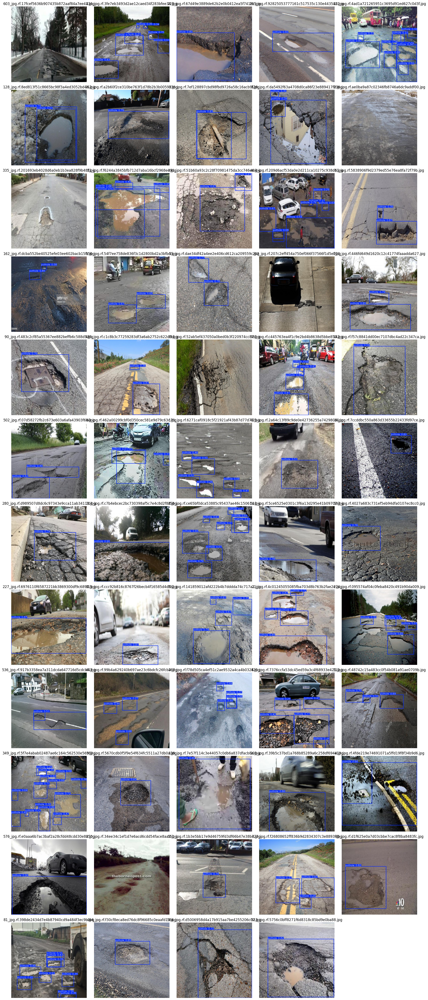

In [13]:
import cv2
import matplotlib.pyplot as plt
import os


predicted_folder = 'runs/detect/predict'

image_files = [f for f in os.listdir(predicted_folder) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]


images_per_row = 5


num_images = len(image_files)
num_rows = (num_images + images_per_row - 1) // images_per_row


plt.figure(figsize=(images_per_row * 4, num_rows * 4))

for idx, file in enumerate(image_files):
    img_path = os.path.join(predicted_folder, file)
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.subplot(num_rows, images_per_row, idx + 1)
    plt.imshow(img)
    plt.axis('off')
    plt.title(file)

plt.tight_layout()
plt.show()
